<a href="https://colab.research.google.com/github/Joocheol/Financial-Engineering/blob/master/Music21.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# music21 - Python-based toolkit for computer-aided musicology.

In [1]:
from music21 import *

In [2]:
n = note.Note("D#3")
n.duration.type = 'half'
n.show()

SubConverterException: ignored

# Some setup

To fix `.show` method, we need some setup. It will take some time.

In [3]:
%%capture

!add-apt-repository ppa:mscore-ubuntu/mscore-stable -y
!apt-get update
!apt-get install musescore

!apt-get install xvfb

!sh -e /etc/init.d/x11-common start

import os
os.putenv('DISPLAY', ':99.0')

!start-stop-daemon --start --pidfile /var/run/xvfb.pid --make-pidfile --background --exec /usr/bin/Xvfb -- :99 -screen 0 1024x768x24 -ac +extension GLX +render -noreset

# converts midi files to wav files into order to play them
print('installing fluidsynth...')
!apt-get install fluidsynth > /dev/null
!cp /usr/share/sounds/sf2/FluidR3_GM.sf2 ./font.sf2

In [4]:
from IPython.display import Image, Audio
from music21 import *

us = environment.UserSettings()
us['musescoreDirectPNGPath'] = '/usr/bin/mscore'
us['directoryScratch'] = '/tmp'

def play(x):
    filename = x.write('mid')
    !fluidsynth -ni font.sf2 $filename -F $filename\.wav -r 16000 > /dev/null
    display(Audio(filename + '.wav'))

# Again, music21 - Python-based toolkit for computer-aided musicology.

In [5]:
from music21 import *

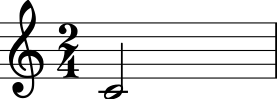

In [6]:
n = note.Note("C4")
n.duration.type = 'half'
n.show()
play(n)

Isn't it nice?

# Chapter 1

In [7]:
from music21 import *
from IPython.display import Audio, Image


You can find more music if you know Bach BWV.

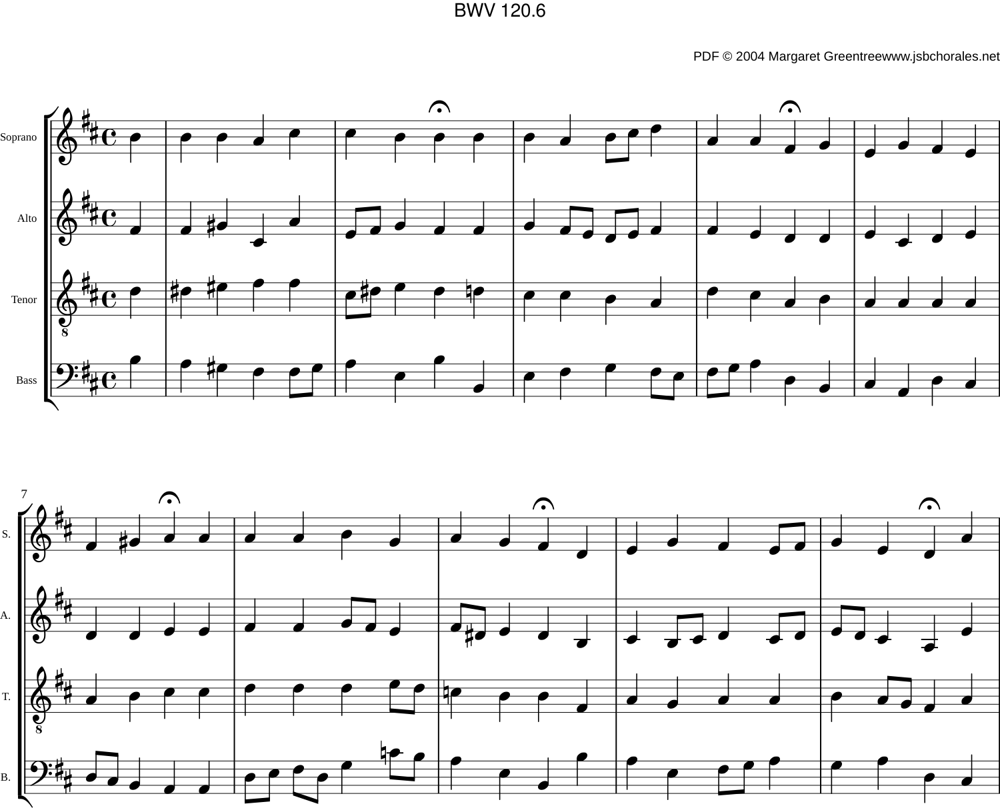

In [8]:
s = corpus.parse('bwv120.6.xml')

s.show()
play(s)

To what's inside the music, we are going to print it.

In [9]:
for i in s:
    print(i)

<music21.text.TextBox "BWV 120.6">
<music21.text.TextBox "PDF © 2004...">
<music21.stream.Part Soprano>
<music21.stream.Part Alto>
<music21.stream.Part Tenor>
<music21.stream.Part Bass>
<music21.layout.ScoreLayout>
<music21.layout.StaffGroup <music21.stream.Part Soprano><music21.stream.Part Alto><music21.stream.Part Tenor><music21.stream.Part Bass>>


# Easy way first
Just take soprano part only. It's on index 3.

In [10]:
for i in s[3]:
    print(i)

P1: Soprano: Instrument 1
<music21.stream.Measure 0 offset=0.0>
<music21.stream.Measure 1 offset=1.0>
<music21.stream.Measure 2 offset=5.0>
<music21.stream.Measure 3 offset=9.0>
<music21.stream.Measure 4 offset=13.0>
<music21.stream.Measure 5 offset=17.0>
<music21.stream.Measure 6 offset=21.0>
<music21.stream.Measure 7 offset=25.0>
<music21.stream.Measure 8 offset=29.0>
<music21.stream.Measure 9 offset=33.0>
<music21.stream.Measure 10 offset=37.0>
<music21.stream.Measure 11 offset=41.0>
<music21.stream.Measure 12 offset=45.0>
<music21.stream.Measure 13 offset=49.0>
<music21.stream.Measure 14 offset=53.0>
<music21.stream.Measure 15 offset=57.0>
<music21.stream.Measure 16 offset=61.0>


Inside the soprano part, there are lot of measures(마디).

`.recurse()` is an easy way to see what is inside recursively.

In [11]:
for i in s[3].recurse():
    print(i)

P1: Soprano: Instrument 1
<music21.stream.Measure 0 offset=0.0>
<music21.clef.TrebleClef>
b minor
<music21.meter.TimeSignature 4/4>
<music21.note.Note B>
<music21.stream.Measure 1 offset=1.0>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note C#>
<music21.stream.Measure 2 offset=5.0>
<music21.note.Note C#>
<music21.note.Note B>
<music21.note.Note B>
<music21.note.Note B>
<music21.stream.Measure 3 offset=9.0>
<music21.note.Note B>
<music21.note.Note A>
<music21.note.Note B>
<music21.note.Note C#>
<music21.note.Note D>
<music21.stream.Measure 4 offset=13.0>
<music21.note.Note A>
<music21.note.Note A>
<music21.note.Note F#>
<music21.note.Note G>
<music21.stream.Measure 5 offset=17.0>
<music21.note.Note E>
<music21.note.Note G>
<music21.note.Note F#>
<music21.note.Note E>
<music21.stream.Measure 6 offset=21.0>
<music21.layout.SystemLayout>
<music21.note.Note F#>
<music21.note.Note G#>
<music21.note.Note A>
<music21.note.Note A>
<music21.stream.Measure 7 of

We can also select the notes(음표) only.

In [12]:
music = []

for i in s[3].recurse().notes:
    #print(i.pitch)
    music.append(i.pitch.nameWithOctave)

music

['B4',
 'B4',
 'B4',
 'A4',
 'C#5',
 'C#5',
 'B4',
 'B4',
 'B4',
 'B4',
 'A4',
 'B4',
 'C#5',
 'D5',
 'A4',
 'A4',
 'F#4',
 'G4',
 'E4',
 'G4',
 'F#4',
 'E4',
 'F#4',
 'G#4',
 'A4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4',
 'D4',
 'E4',
 'G4',
 'F#4',
 'E4',
 'F#4',
 'G4',
 'E4',
 'D4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4',
 'G4',
 'G4',
 'G4',
 'F#4',
 'E4',
 'G4',
 'E4',
 'D4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4']

Ok. Let's define a function that can extract notes only.

In [13]:
def extract_notes(x):
    temp = []

    for i in x.recurse().notes:
        temp.append(i.pitch.nameWithOctave)

    return temp

music_note = extract_notes(s[3]) #4 is the alto part
music_note

['B4',
 'B4',
 'B4',
 'A4',
 'C#5',
 'C#5',
 'B4',
 'B4',
 'B4',
 'B4',
 'A4',
 'B4',
 'C#5',
 'D5',
 'A4',
 'A4',
 'F#4',
 'G4',
 'E4',
 'G4',
 'F#4',
 'E4',
 'F#4',
 'G#4',
 'A4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4',
 'D4',
 'E4',
 'G4',
 'F#4',
 'E4',
 'F#4',
 'G4',
 'E4',
 'D4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4',
 'G4',
 'G4',
 'G4',
 'F#4',
 'E4',
 'G4',
 'E4',
 'D4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4']

Now put it back to music.

In [14]:
def data_to_music(x):
    
    ss = stream.Stream()

    for i in x:
        n = note.Note(i)
        ss.append(n)

    ss.show()
    return ss

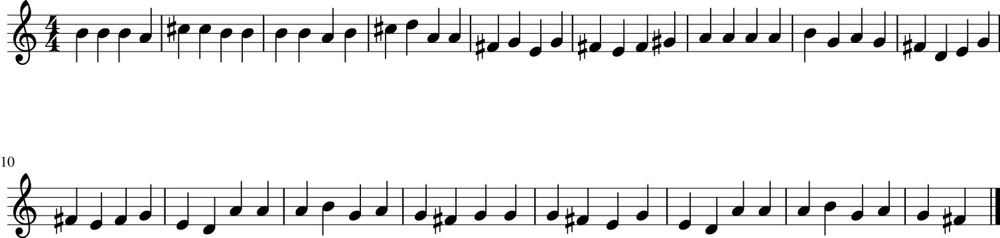

In [15]:
dt = data_to_music(music_note)
play(dt)

That means you can make your own music by just writing notes.

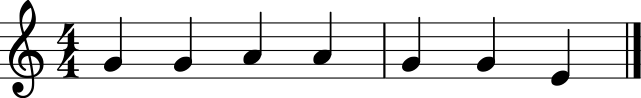

In [16]:
# sol, sol, la, la, sol, sol, mi

my_song = ['G4', 'G4', 'A4', 'A4', 'G4', 'G4', 'E4']

dt = data_to_music(my_song)
play(dt)


# Save it on colab. 
You can download it to your computer. Use your left side menu.

In [17]:
dt.write('midi', "mymymusic.mid")

'mymymusic.mid'

# `Chordify`

Bring the next score to your friends who can play the piano. They might not play this, but you can.

Did you notice that this is the same score as you saw at the beginning. It is just chordified.

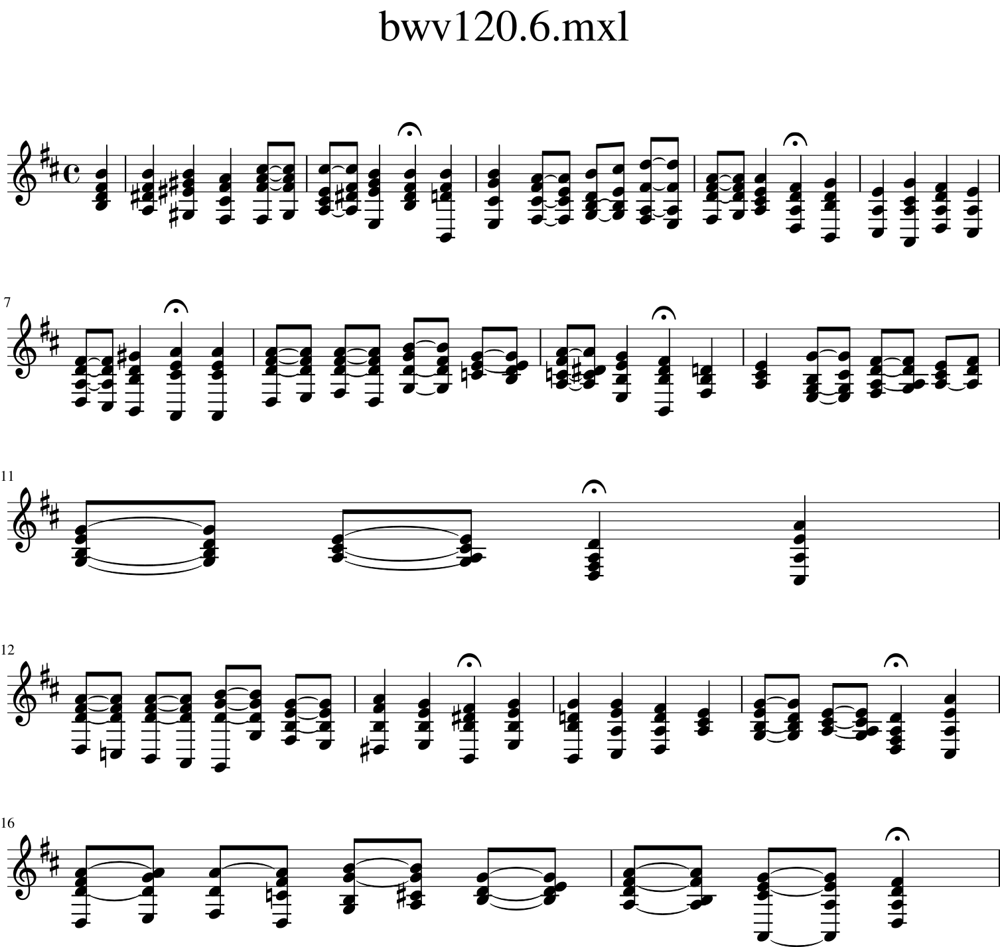

In [18]:
s = corpus.parse('bwv120.6.xml')

s.chordify().show()

play(s)

# Connect music21 to TensorFlow

In [19]:
import numpy as np
import tensorflow as tf

from music21 import *

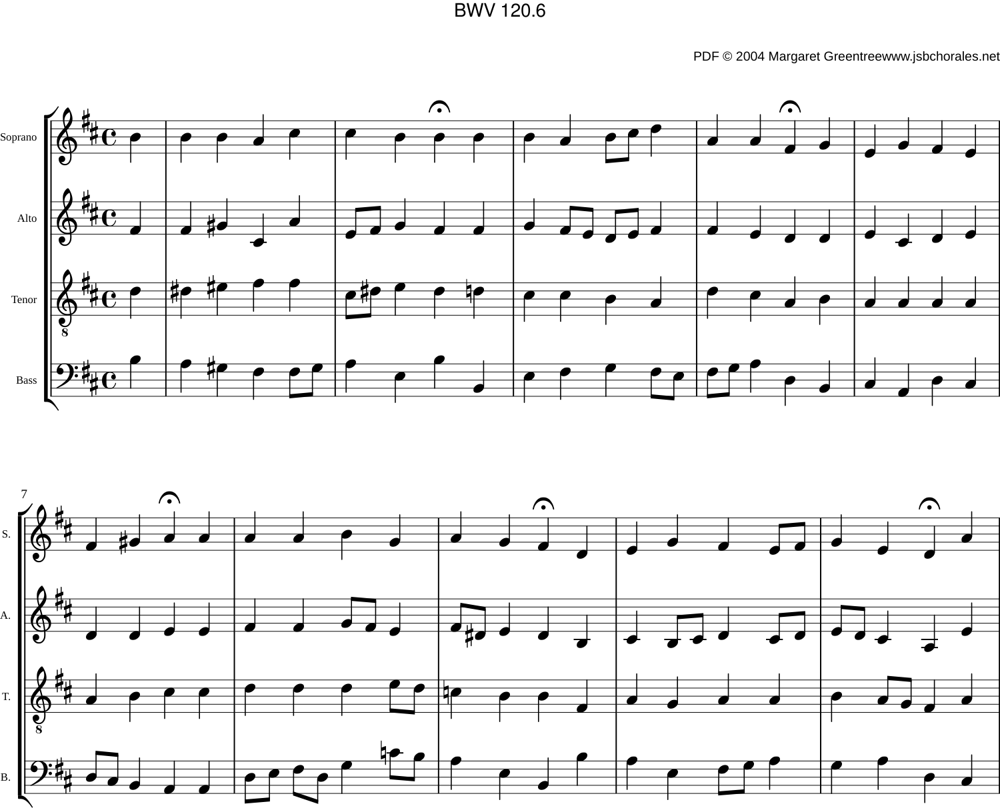

In [20]:
s = corpus.parse('bwv120.6.xml')

s.show()

In [21]:
ds = extract_notes(s[3])
print(ds)

# To see how many different notes are used
set(ds)

['B4', 'B4', 'B4', 'A4', 'C#5', 'C#5', 'B4', 'B4', 'B4', 'B4', 'A4', 'B4', 'C#5', 'D5', 'A4', 'A4', 'F#4', 'G4', 'E4', 'G4', 'F#4', 'E4', 'F#4', 'G#4', 'A4', 'A4', 'A4', 'A4', 'B4', 'G4', 'A4', 'G4', 'F#4', 'D4', 'E4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'E4', 'D4', 'A4', 'A4', 'A4', 'B4', 'G4', 'A4', 'G4', 'F#4', 'G4', 'G4', 'G4', 'F#4', 'E4', 'G4', 'E4', 'D4', 'A4', 'A4', 'A4', 'B4', 'G4', 'A4', 'G4', 'F#4']


{'A4', 'B4', 'C#5', 'D4', 'D5', 'E4', 'F#4', 'G#4', 'G4'}

In [22]:
vocab = list(set(ds))
vocab

['D5', 'G#4', 'E4', 'B4', 'F#4', 'G4', 'A4', 'C#5', 'D4']

# Vectorize the text

In [23]:
tf.keras.layers.experimental.preprocessing.StringLookup()

This layer can convert each notes into numeric ID.

In [24]:
f1 = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=vocab)

In [25]:
f1(ds)

<tf.Tensor: shape=(66,), dtype=int64, numpy=
array([4, 4, 4, 7, 8, 8, 4, 4, 4, 4, 7, 4, 8, 1, 7, 7, 5, 6, 3, 6, 5, 3,
       5, 2, 7, 7, 7, 7, 4, 6, 7, 6, 5, 9, 3, 6, 5, 3, 5, 6, 3, 9, 7, 7,
       7, 4, 6, 7, 6, 5, 6, 6, 6, 5, 3, 6, 3, 9, 7, 7, 7, 4, 6, 7, 6, 5])>

This is the music represented by ID's. We just ignore the duration of each note.

We also need to convert it back to musical notes.

In [26]:
f2 = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=f1.get_vocabulary(), invert=True)

In [27]:
tmp = f1(ds)


f2(tmp)

<tf.Tensor: shape=(66,), dtype=string, numpy=
array([b'B4', b'B4', b'B4', b'A4', b'C#5', b'C#5', b'B4', b'B4', b'B4',
       b'B4', b'A4', b'B4', b'C#5', b'D5', b'A4', b'A4', b'F#4', b'G4',
       b'E4', b'G4', b'F#4', b'E4', b'F#4', b'G#4', b'A4', b'A4', b'A4',
       b'A4', b'B4', b'G4', b'A4', b'G4', b'F#4', b'D4', b'E4', b'G4',
       b'F#4', b'E4', b'F#4', b'G4', b'E4', b'D4', b'A4', b'A4', b'A4',
       b'B4', b'G4', b'A4', b'G4', b'F#4', b'G4', b'G4', b'G4', b'F#4',
       b'E4', b'G4', b'E4', b'D4', b'A4', b'A4', b'A4', b'B4', b'G4',
       b'A4', b'G4', b'F#4'], dtype=object)>

In [28]:
ds

['B4',
 'B4',
 'B4',
 'A4',
 'C#5',
 'C#5',
 'B4',
 'B4',
 'B4',
 'B4',
 'A4',
 'B4',
 'C#5',
 'D5',
 'A4',
 'A4',
 'F#4',
 'G4',
 'E4',
 'G4',
 'F#4',
 'E4',
 'F#4',
 'G#4',
 'A4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4',
 'D4',
 'E4',
 'G4',
 'F#4',
 'E4',
 'F#4',
 'G4',
 'E4',
 'D4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4',
 'G4',
 'G4',
 'G4',
 'F#4',
 'E4',
 'G4',
 'E4',
 'D4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4']

In [29]:
f2(tmp).numpy()

array([b'B4', b'B4', b'B4', b'A4', b'C#5', b'C#5', b'B4', b'B4', b'B4',
       b'B4', b'A4', b'B4', b'C#5', b'D5', b'A4', b'A4', b'F#4', b'G4',
       b'E4', b'G4', b'F#4', b'E4', b'F#4', b'G#4', b'A4', b'A4', b'A4',
       b'A4', b'B4', b'G4', b'A4', b'G4', b'F#4', b'D4', b'E4', b'G4',
       b'F#4', b'E4', b'F#4', b'G4', b'E4', b'D4', b'A4', b'A4', b'A4',
       b'B4', b'G4', b'A4', b'G4', b'F#4', b'G4', b'G4', b'G4', b'F#4',
       b'E4', b'G4', b'E4', b'D4', b'A4', b'A4', b'A4', b'B4', b'G4',
       b'A4', b'G4', b'F#4'], dtype=object)

I want to put it back to the normal list without b.

In [30]:
tmp2 = f2(tmp).numpy()

my_list = [i.decode('utf-8') for i in tmp2]
my_list

['B4',
 'B4',
 'B4',
 'A4',
 'C#5',
 'C#5',
 'B4',
 'B4',
 'B4',
 'B4',
 'A4',
 'B4',
 'C#5',
 'D5',
 'A4',
 'A4',
 'F#4',
 'G4',
 'E4',
 'G4',
 'F#4',
 'E4',
 'F#4',
 'G#4',
 'A4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4',
 'D4',
 'E4',
 'G4',
 'F#4',
 'E4',
 'F#4',
 'G4',
 'E4',
 'D4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4',
 'G4',
 'G4',
 'G4',
 'F#4',
 'E4',
 'G4',
 'E4',
 'D4',
 'A4',
 'A4',
 'A4',
 'B4',
 'G4',
 'A4',
 'G4',
 'F#4']

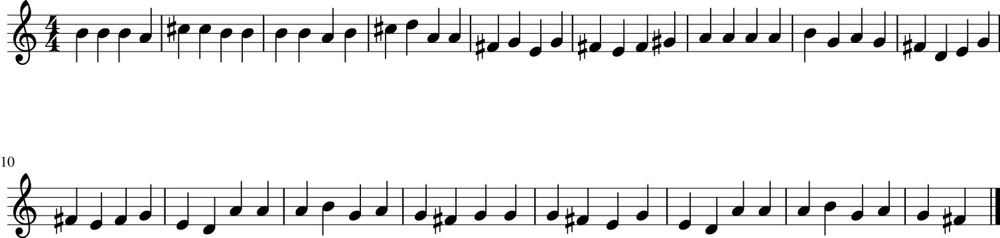

<music21.stream.Stream 0x7fb57e669a90>

In [31]:
data_to_music(my_list)

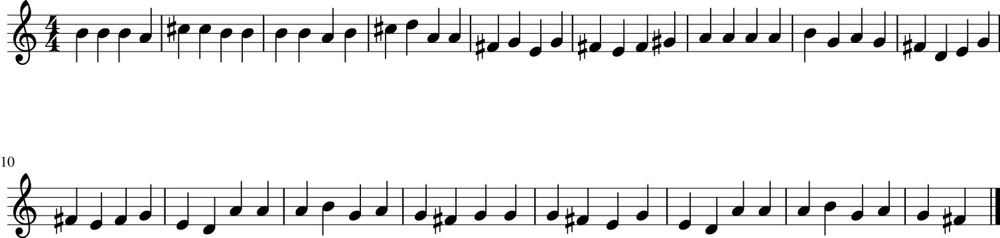

In [32]:
play(data_to_music(my_list))

In [33]:
tmp

<tf.Tensor: shape=(66,), dtype=int64, numpy=
array([4, 4, 4, 7, 8, 8, 4, 4, 4, 4, 7, 4, 8, 1, 7, 7, 5, 6, 3, 6, 5, 3,
       5, 2, 7, 7, 7, 7, 4, 6, 7, 6, 5, 9, 3, 6, 5, 3, 5, 6, 3, 9, 7, 7,
       7, 4, 6, 7, 6, 5, 6, 6, 6, 5, 3, 6, 3, 9, 7, 7, 7, 4, 6, 7, 6, 5])>

# Summary

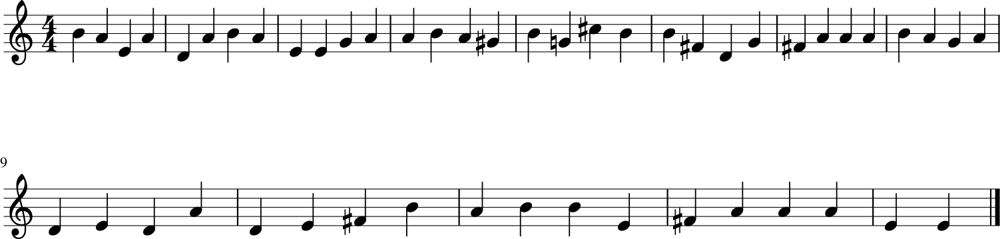

In [34]:
s = corpus.parse('bwv120.6.xml')

ds = extract_notes(s[3])


set(ds)
vocab = list(set(ds))

f1 = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=vocab)
f2 = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=f1.get_vocabulary(), invert=True)

dataset = f1(ds)

# From here 
# Tensorflow will do some jobs
# And produce output
output = np.random.choice(dataset, size=50)
# Once you have it, you can play.

tmp = f2(output).numpy()

my_list = [i.decode('utf-8') for i in tmp]

play(data_to_music(my_list))

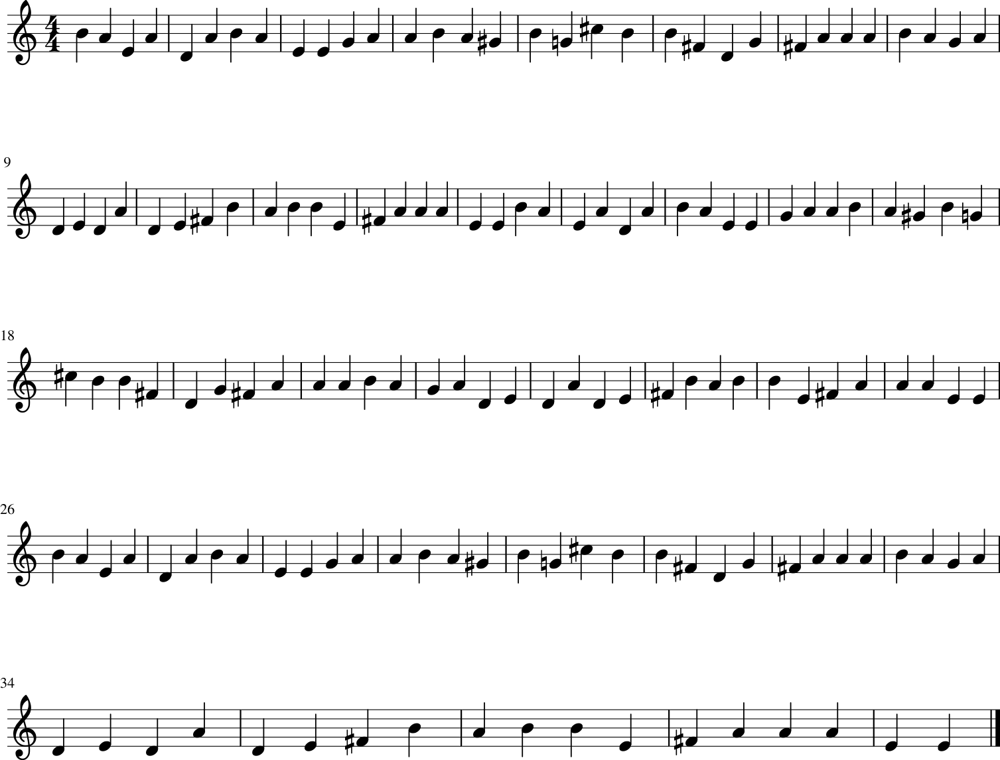

In [35]:
play(data_to_music(my_list*3))

# Copy of TensorFlow code

In [36]:
s = corpus.parse('bwv120.6.xml')

ds = extract_notes(s[3])

ds_1 = ds * 100


set(ds_1)
vocab = list(set(ds_1))

f1 = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=vocab)
f2 = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=f1.get_vocabulary(), invert=True)

ds_2 = f1(ds_1)

In [37]:
ds_3 = tf.data.Dataset.from_tensor_slices(ds_2)

seq_length = 100
examples_per_epoch = len(ds_1)//(seq_length+1)

ds_4 = ds_3.batch(seq_length+1, drop_remainder=True)


In [38]:
def split_input_target(sequence):
    input_text = sequence[:-1]
    target_text = sequence[1:]
    return input_text, target_text

ds_5 = ds_4.map(split_input_target)

In [39]:
BATCH_SIZE = 32

ds_6 = ds_5.batch(BATCH_SIZE, drop_remainder=True)


In [40]:
for i in ds_6.take(1):
    print(i)

(<tf.Tensor: shape=(32, 100), dtype=int64, numpy=
array([[4, 4, 4, ..., 6, 5, 9],
       [6, 5, 3, ..., 4, 4, 4],
       [8, 8, 4, ..., 6, 5, 3],
       ...,
       [7, 7, 7, ..., 3, 9, 7],
       [7, 4, 6, ..., 7, 7, 7],
       [6, 7, 6, ..., 7, 4, 6]])>, <tf.Tensor: shape=(32, 100), dtype=int64, numpy=
array([[4, 4, 7, ..., 5, 9, 3],
       [5, 3, 5, ..., 4, 4, 7],
       [8, 4, 4, ..., 5, 3, 5],
       ...,
       [7, 7, 4, ..., 9, 7, 7],
       [4, 6, 7, ..., 7, 7, 4],
       [7, 6, 5, ..., 4, 6, 7]])>)


In [41]:
# Length of the vocabulary in chars
vocab_size = len(vocab)

# The embedding dimension
embedding_dim = 256

# Number of RNN units
rnn_units = 1024

In [42]:
class MyModel(tf.keras.Model):
  def __init__(self, vocab_size, embedding_dim, rnn_units):
    super().__init__(self)
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.gru = tf.keras.layers.GRU(rnn_units,
                                   return_sequences=True,
                                   return_state=True)
    self.dense = tf.keras.layers.Dense(vocab_size)

  def call(self, inputs, states=None, return_state=False, training=False):
    x = inputs
    x = self.embedding(x, training=training)
    if states is None:
      states = self.gru.get_initial_state(x)
    x, states = self.gru(x, initial_state=states, training=training)
    x = self.dense(x, training=training)

    if return_state:
      return x, states
    else:
      return x

In [43]:
model = MyModel(
    # Be sure the vocabulary size matches the `StringLookup` layers.
    vocab_size=len(f1.get_vocabulary()),
    embedding_dim=embedding_dim,
    rnn_units=rnn_units)

In [44]:
loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

model.compile(optimizer='adam', loss=loss)

In [45]:
EPOCHS = 2

history = model.fit(ds_6, epochs=EPOCHS)

Epoch 1/2
2/2 [==============================] - 11s 4s/step - loss: 2.2639
Epoch 2/2
2/2 [==============================] - 7s 4s/step - loss: 2.0371


In [46]:
class OneStep(tf.keras.Model):
  def __init__(self, model):
    super().__init__()
    self.temperature = 1
    self.model = model

    # Create a mask to prevent "[UNK]" from being generated.
    skip_ids = f1(['[UNK]'])[:, None]
    sparse_mask = tf.SparseTensor(
        # Put a -inf at each bad index.
        values=[-float('inf')]*len(skip_ids),
        indices=skip_ids,
        # Match the shape to the vocabulary
        dense_shape=[len(f1.get_vocabulary())])
    self.prediction_mask = tf.sparse.to_dense(sparse_mask)

  @tf.function
  def generate_one_step(self, inputs, states=None):
    # Convert strings to token IDs.
    #input_chars = np.array(inputs)
    input_ids = f1(inputs)
    input_ids = tf.reshape(input_ids, [1,-1])

    # Run the model.
    # predicted_logits.shape is [batch, char, next_char_logits]
    predicted_logits, states = self.model(inputs=input_ids, states=states,
                                          return_state=True)
    # Only use the last prediction.
    predicted_logits = predicted_logits[:, -1, :]
    predicted_logits = predicted_logits/self.temperature
    # Apply the prediction mask: prevent "[UNK]" from being generated.
    predicted_logits = predicted_logits + self.prediction_mask

    # Sample the output logits to generate token IDs.
    predicted_ids = tf.random.categorical(predicted_logits, num_samples=1)
    predicted_ids = tf.squeeze(predicted_ids, axis=-1)

    # Convert from token ids to characters
    predicted_chars = f2(predicted_ids)

    # Return the characters and model state.
    return predicted_chars, states

In [47]:
one_step_model = OneStep(model)

In [48]:
import time

start = time.time()
states = None
next_char = tf.constant(['G4'])
result = [next_char]

for n in range(1000):
  next_char, states = one_step_model.generate_one_step(next_char, states=states)
  result.append(next_char)

result = tf.strings.join(result, separator=' ')
end = time.time()
print(result[0].numpy().decode('utf-8'), '\n\n' + '_'*80)
print('\nRun time:', end - start)

G4 G#4 F#4 F#4 B4 G#4 A4 A4 D4 A4 F#4 A4 A4 F#4 F#4 A4 G4 B4 A4 A4 G4 A4 B4 G4 A4 B4 G4 A4 G4 A4 A4 A4 A4 G4 G4 G4 A4 G4 A4 G4 G4 A4 G4 A4 G4 G4 G4 A4 A4 G4 A4 G4 A4 G4 A4 A4 A4 G4 G4 G4 A4 G4 G4 A4 A4 A4 A4 A4 G4 A4 A4 A4 A4 A4 G4 A4 A4 A4 A4 G4 A4 A4 G4 A4 A4 A4 A4 A4 G4 G4 A4 G4 G4 A4 A4 A4 G4 A4 A4 A4 G4 A4 G4 A4 G4 A4 A4 G4 G4 A4 A4 A4 G4 A4 A4 G4 A4 G4 A4 G4 G4 G4 A4 A4 A4 A4 A4 G4 A4 A4 G4 A4 A4 G4 G4 G4 G4 A4 G4 G4 G4 A4 A4 A4 G4 G4 A4 G4 G4 G4 A4 G4 A4 A4 A4 A4 A4 G4 G4 G4 A4 A4 G4 A4 G4 G4 A4 A4 G4 A4 A4 G4 A4 A4 A4 A4 G4 A4 A4 A4 A4 G4 A4 A4 G4 A4 G4 A4 G4 A4 G4 A4 A4 G4 G4 A4 G4 A4 A4 A4 G4 G4 G4 A4 A4 G4 G4 A4 G4 A4 A4 A4 A4 A4 A4 A4 A4 G4 G4 G4 A4 A4 G4 G4 G4 G4 A4 A4 G4 A4 A4 A4 A4 G4 G4 A4 A4 G4 A4 A4 A4 G4 A4 A4 A4 A4 G4 G4 G4 A4 A4 G4 A4 G4 G4 A4 G4 G4 G4 G4 G4 A4 G4 A4 G4 A4 A4 A4 G4 A4 A4 G4 A4 A4 A4 G4 A4 A4 A4 A4 G4 A4 A4 G4 A4 G4 G4 A4 G4 A4 G4 A4 G4 A4 A4 G4 A4 A4 A4 G4 G4 G4 A4 A4 G4 A4 A4 A4 A4 A4 A4 A4 A4 G4 A4 G4 A4 G4 A4 G4 G4 G4 A4 A4 G4 A4 G4 G4 G4 G4 A4 

In [49]:
answer = result[0].numpy().decode('utf-8').split()

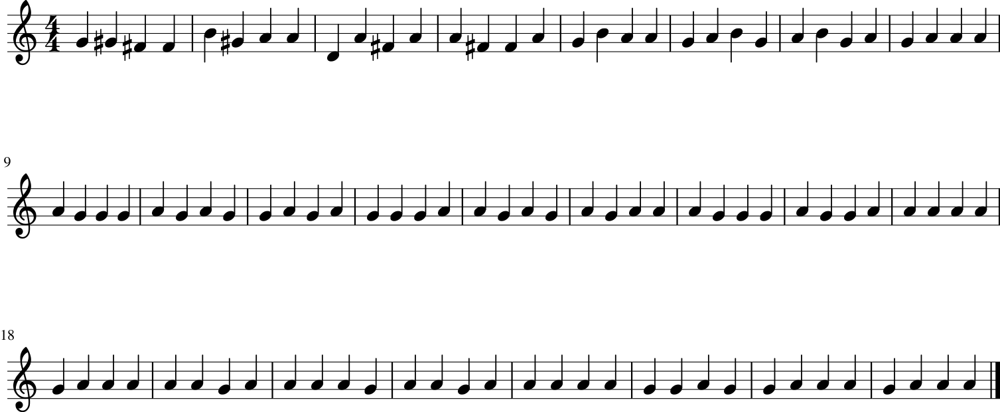

In [50]:
play(data_to_music(answer[:100]))

# Try bigger

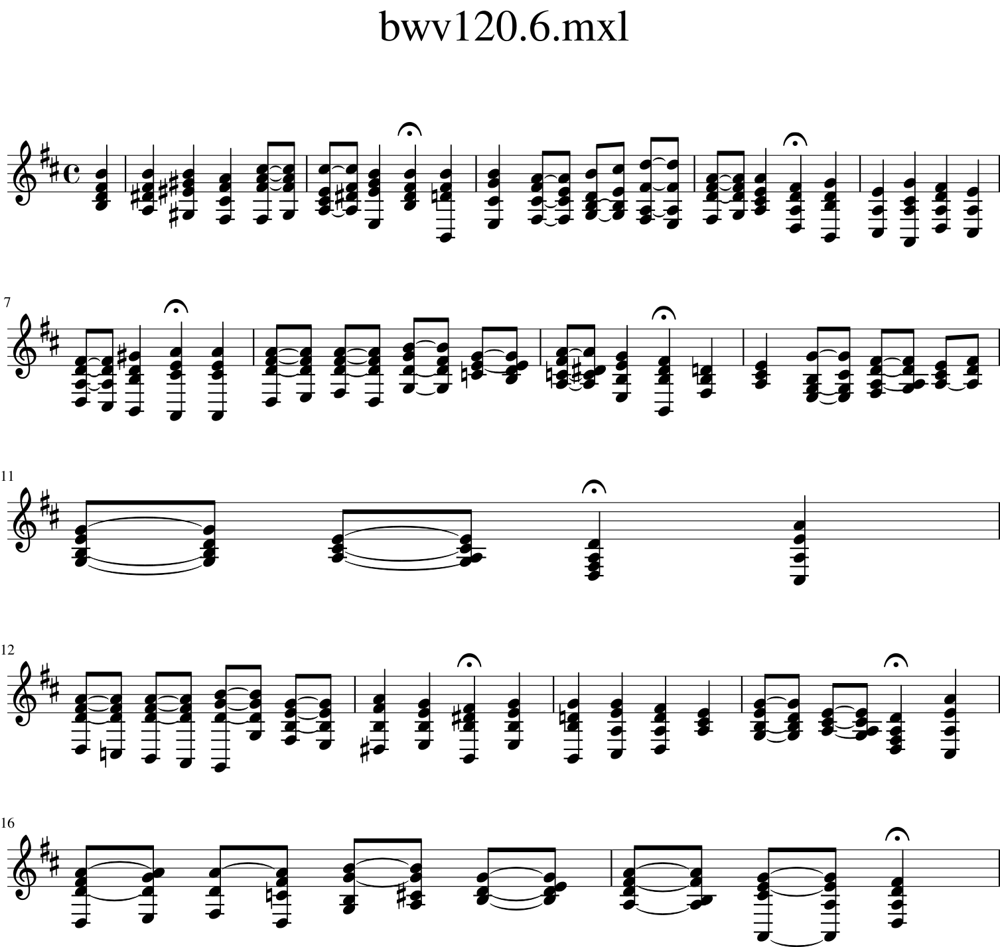

In [51]:
s = corpus.parse('bwv120.6.xml')

s.chordify().show()

play(s)

In [52]:
for i in s.chordify().recurse().notes:
    print(i)

<music21.chord.Chord B3 D4 F#4 B4>
<music21.chord.Chord A3 D#4 F#4 B4>
<music21.chord.Chord G#3 E#4 G#4 B4>
<music21.chord.Chord F#3 C#4 F#4 A4>
<music21.chord.Chord F#3 F#4 A4 C#5>
<music21.chord.Chord G#3 F#4 A4 C#5>
<music21.chord.Chord A3 C#4 E4 C#5>
<music21.chord.Chord A3 D#4 F#4 C#5>
<music21.chord.Chord E3 E4 G4 B4>
<music21.chord.Chord B3 D#4 F#4 B4>
<music21.chord.Chord B2 D4 F#4 B4>
<music21.chord.Chord E3 C#4 G4 B4>
<music21.chord.Chord F#3 C#4 F#4 A4>
<music21.chord.Chord F#3 C#4 E4 A4>
<music21.chord.Chord G3 B3 D4 B4>
<music21.chord.Chord G3 B3 E4 C#5>
<music21.chord.Chord F#3 A3 F#4 D5>
<music21.chord.Chord E3 A3 F#4 D5>
<music21.chord.Chord F#3 D4 F#4 A4>
<music21.chord.Chord G3 D4 F#4 A4>
<music21.chord.Chord A3 C#4 E4 A4>
<music21.chord.Chord D3 A3 D4 F#4>
<music21.chord.Chord B2 B3 D4 G4>
<music21.chord.Chord C#3 A3 E4>
<music21.chord.Chord A2 A3 C#4 G4>
<music21.chord.Chord D3 A3 D4 F#4>
<music21.chord.Chord C#3 A3 E4>
<music21.chord.Chord D3 A3 D4 F#4>
<music21.ch